In [52]:
import random

import cv2 as cv
from matplotlib import pyplot as plt
import numpy as np

In [53]:
! pwd

/Users/yuliiakholodetska/Desktop/cv/cv-2023/group 412/lab2/Kholodetska


In [54]:
# Different contrasts
file_1 = "golf.jpg"
# Different details of objects
file_2 = "flower.jpeg"
# Different details of objects
file_3 = "newyork.jpg"
# Different contrasts
file_4= "universe.jpg"

In [55]:
def visualize(image):
    plt.figure(figsize=(15, 5), dpi=150)
    plt.imshow(image)


def read(file):
    return cv.cvtColor(cv.imread(file, cv.IMREAD_COLOR), cv.COLOR_BGR2RGB)


def surf_bf_matcher(image, query, matches_number=7):
    surf = cv.xfeatures2d.SURF_create()
    kp1, des1 = surf.detectAndCompute(cv.cvtColor(image, cv.COLOR_BGR2GRAY), None)
    kp2, des2 = surf.detectAndCompute(cv.cvtColor(query, cv.COLOR_BGR2GRAY), None)

    bf = cv.BFMatcher(cv.NORM_L2, crossCheck=True)
    matches = bf.match(des1, des2)

    matches = sorted(matches, key=lambda sample: sample.distance)

    return cv.drawMatches(image, kp1, query, kp2, matches[:matches_number], None, flags=2)


def surf_custom_matcher(image, query, matches_number=7):
    surf = cv.xfeatures2d.SURF_create()
    kp1, des1 = surf.detectAndCompute(cv.cvtColor(image, cv.COLOR_BGR2GRAY), None)
    kp2, des2 = surf.detectAndCompute(cv.cvtColor(query, cv.COLOR_BGR2GRAY), None)

    matches = []
    for i, d1 in enumerate(des1, start=0):
        for j, d2 in enumerate(des2, start=0):
            matches.append(cv.DMatch(_trainIdx=j, _queryIdx=i, _distance=np.linalg.norm(d1 - d2, ord=2), _imgIdx=0))

    matches = sorted(matches, key=lambda sample: sample.distance)

    return cv.drawMatches(image, kp1, query, kp2, matches[:matches_number], None, flags=2)


def ransac(matches, kp1, kp2, iterations=2000, threshold=5):
    best_inliers = []
    for _ in range(iterations):
        samples = random.sample(matches, 4)
        src_pts = np.array([kp1[sample.queryIdx].pt for sample in samples]).reshape(-1,1,2)
        dst_pts = np.array([kp2[sample.trainIdx].pt for sample in samples]).reshape(-1,1,2)
        H, _ = cv.findHomography(src_pts, dst_pts, cv.RANSAC, threshold)

        inliers = []
        for sample in matches:
            src_pt = np.array(kp1[sample.queryIdx].pt).reshape(-1,1,2)
            dst_pt = np.array(kp2[sample.trainIdx].pt).reshape(-1,1,2)
            transformed_pt = cv.perspectiveTransform(src_pt, H)
            dist = np.linalg.norm(dst_pt - transformed_pt)
            if dist < threshold:
                inliers.append(sample)

        if len(inliers) > len(best_inliers):
            best_inliers = inliers

    src_pts = np.array([kp1[sample.queryIdx].pt for sample in best_inliers]).reshape(-1,1,2)
    dst_pts = np.array([kp2[sample.trainIdx].pt for sample in best_inliers]).reshape(-1,1,2)
    H, _ = cv.findHomography(src_pts, dst_pts, 0)

    return H, best_inliers

def surf_ransac_matcher(image, query, matches_number=7):
    surf = cv.xfeatures2d.SURF_create()
    kp1, des1 = surf.detectAndCompute(cv.cvtColor(image, cv.COLOR_BGR2GRAY), None)
    kp2, des2 = surf.detectAndCompute(cv.cvtColor(query, cv.COLOR_BGR2GRAY), None)

    bf = cv.BFMatcher(cv.NORM_L2, crossCheck=False)
    matches = bf.match(des1, des2)

    H, inliers = ransac(matches, kp1, kp2)

    return cv.drawMatches(image, kp1, query, kp2, inliers[:matches_number], None, flags=2)



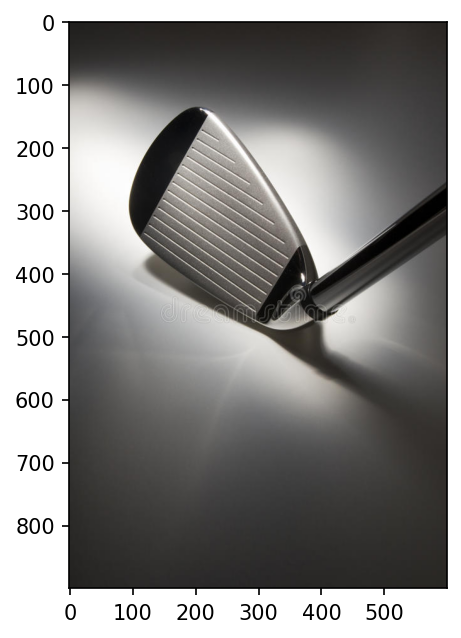

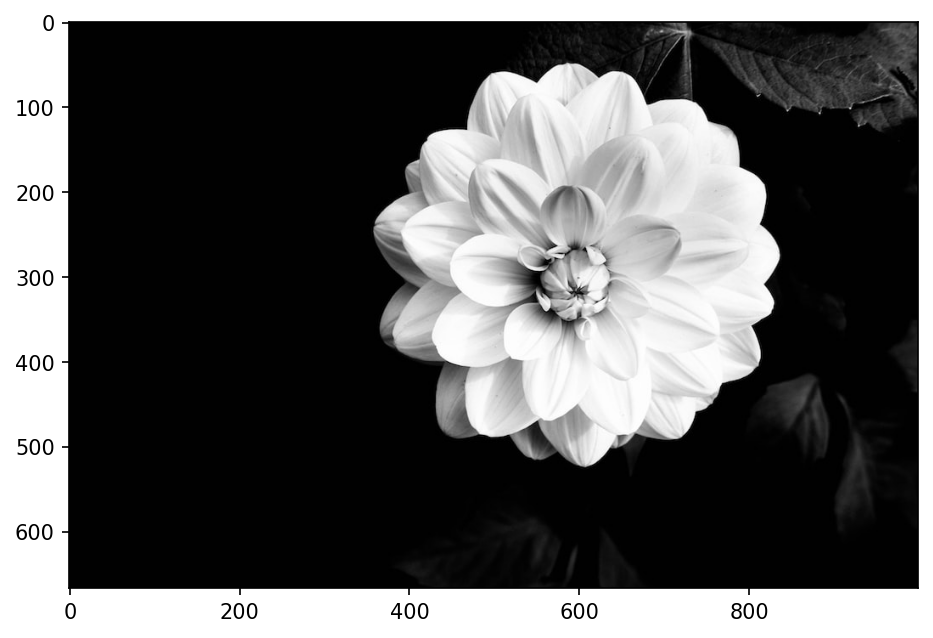

In [56]:
image_1 = read(file=file_1)
image_2 = read(file=file_2)
visualize(image=image_1)
visualize(image=image_2)

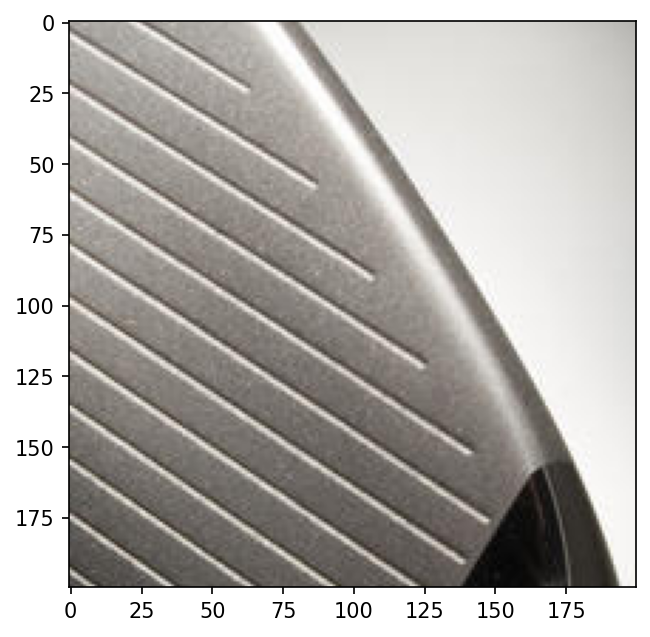

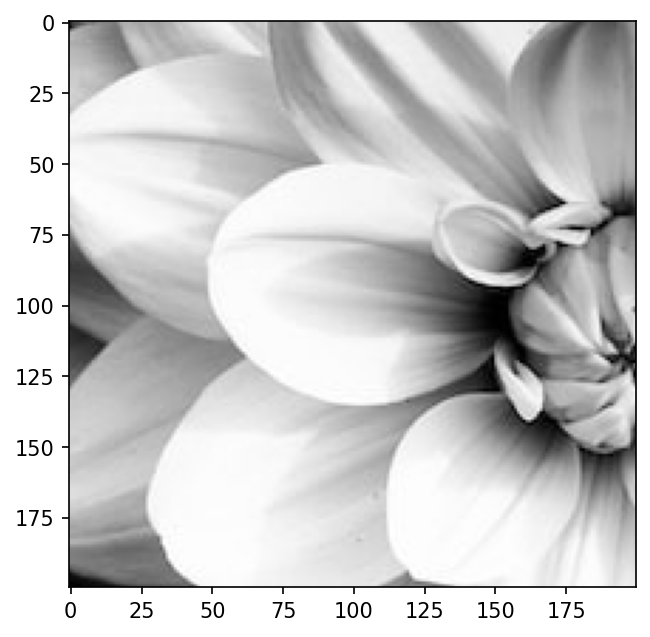

In [62]:
crop_1 = image_1[200:400, 200:400]
crop_2 = image_2[200:400, 400:600]
visualize(image=crop_1)
visualize(image=crop_2)

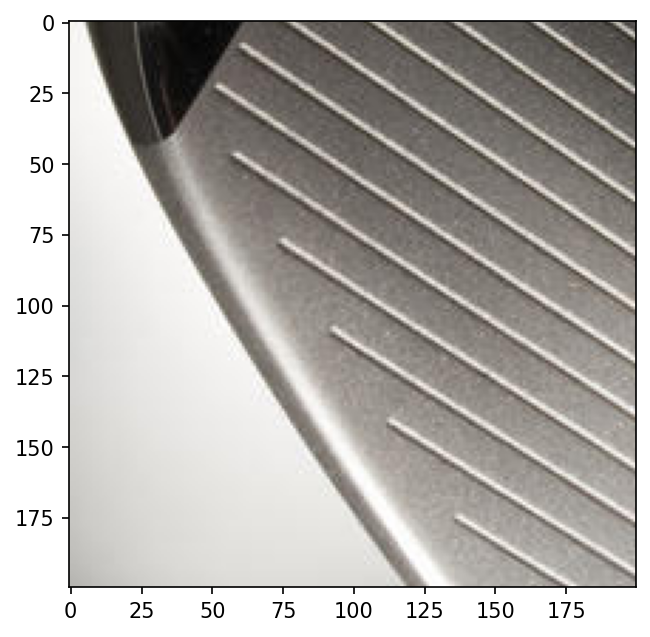

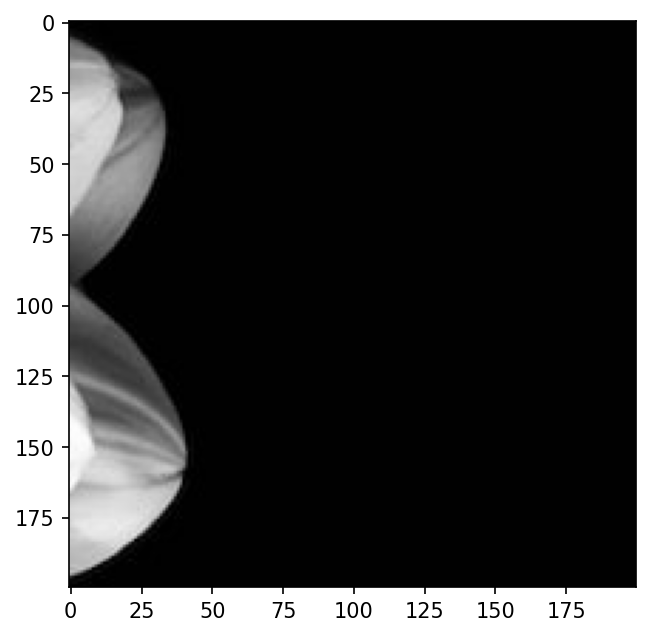

In [47]:
query_1 = cv.rotate(crop_1, cv.ROTATE_180)
query_2 = cv.rotate(crop_2, cv.ROTATE_180)
visualize(image=query_1)
visualize(image=query_2)

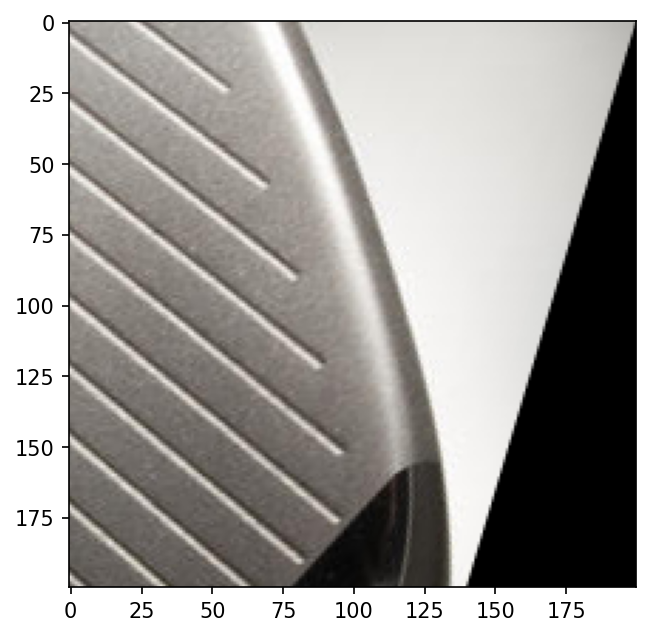

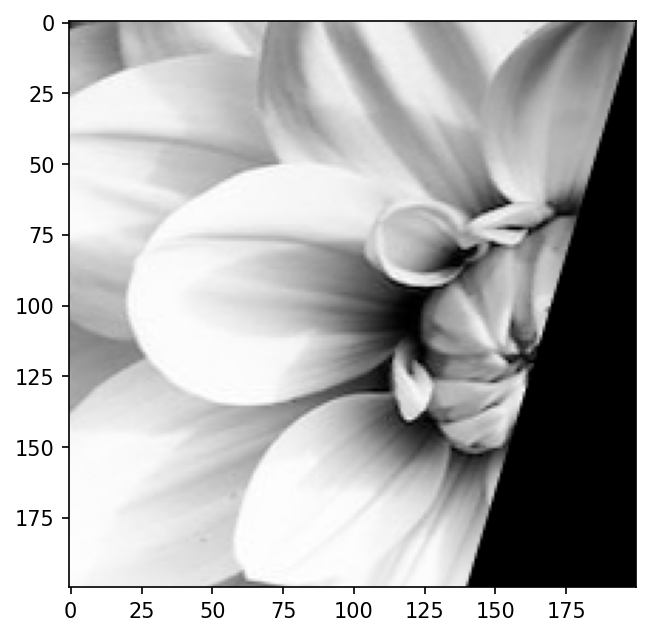

In [63]:
query_1_2 = cv.warpAffine(crop_1, np.array([[1, -0.3, 0], [0, 1, 0]]), crop_1.shape[:2][::-1])
query_2_2 = cv.warpAffine(crop_2, np.array([[1, -0.3, 0], [0, 1, 0]]), crop_2.shape[:2][::-1])
#query2 = cv.warpAffine(crop, np.array([[1, 0, 0], [0.3, 1, 0]]), crop.shape[:2][::-1]) y
visualize(image=query_1_2)
visualize(image=query_2_2)

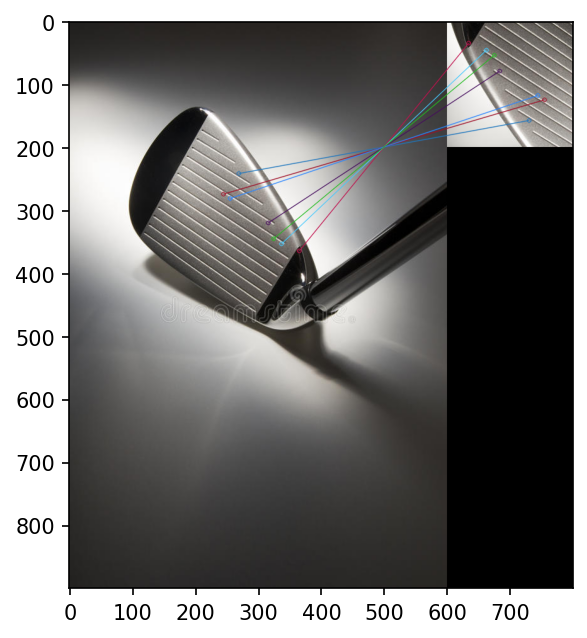

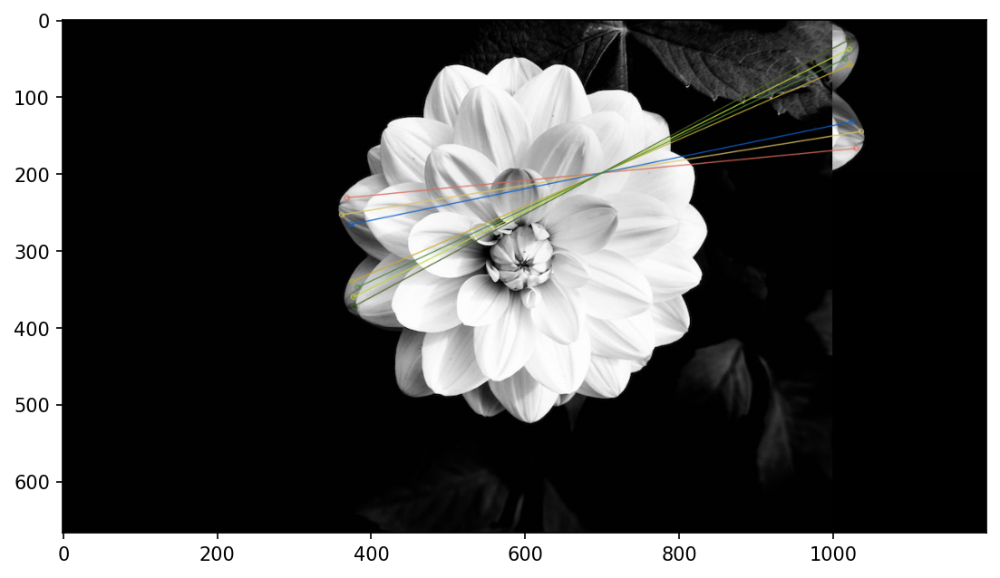

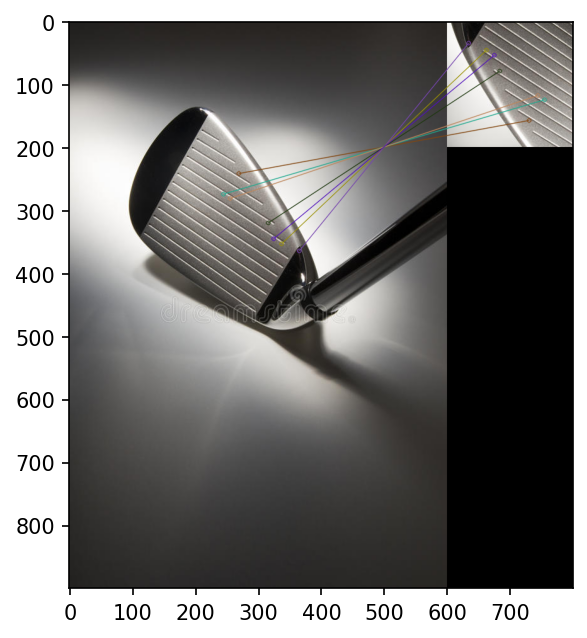

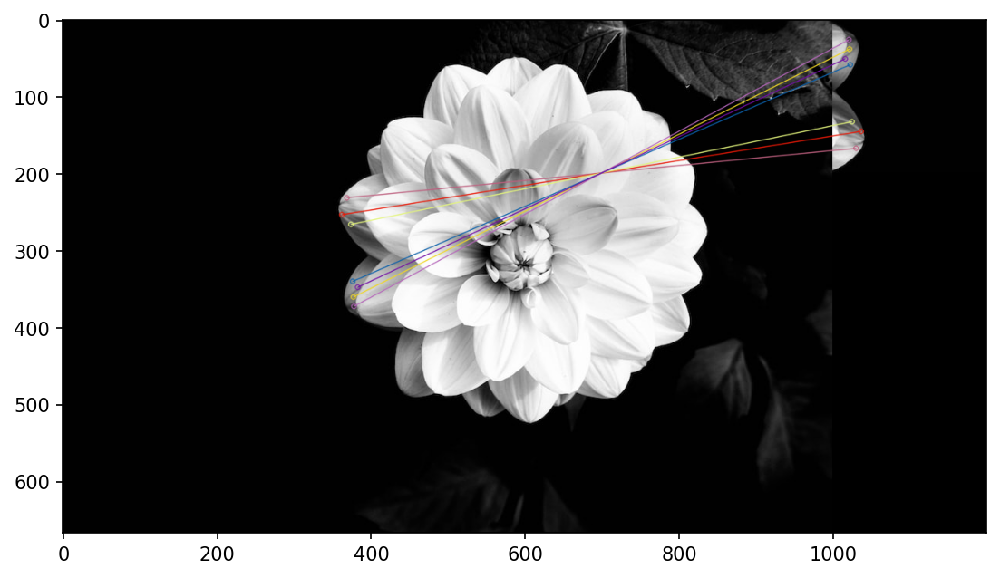

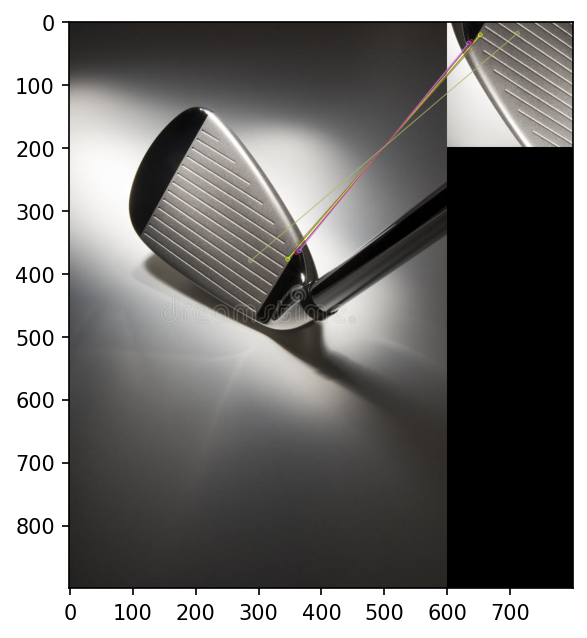

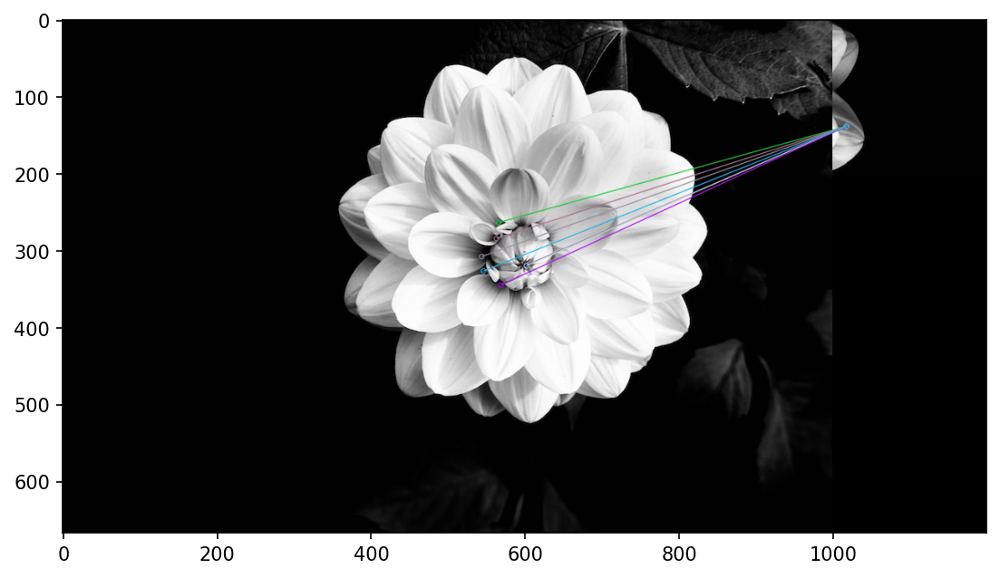

In [69]:
visualize(image=surf_bf_matcher(image=image_1, query=query_1, matches_number=7))
visualize(image=surf_bf_matcher(image=image_2, query=query_2, matches_number=7))
visualize(image=surf_custom_matcher(image=image_1, query=query_1, matches_number=7))
visualize(image=surf_custom_matcher(image=image_2, query=query_2, matches_number=7))
visualize(image=surf_ransac_matcher(image=image_1, query=query_1, matches_number=7))
visualize(image=surf_ransac_matcher(image=image_2, query=query_2, matches_number=7))

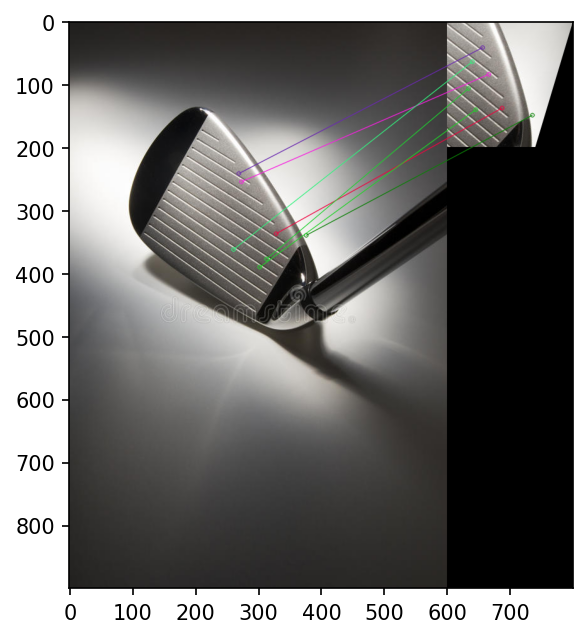

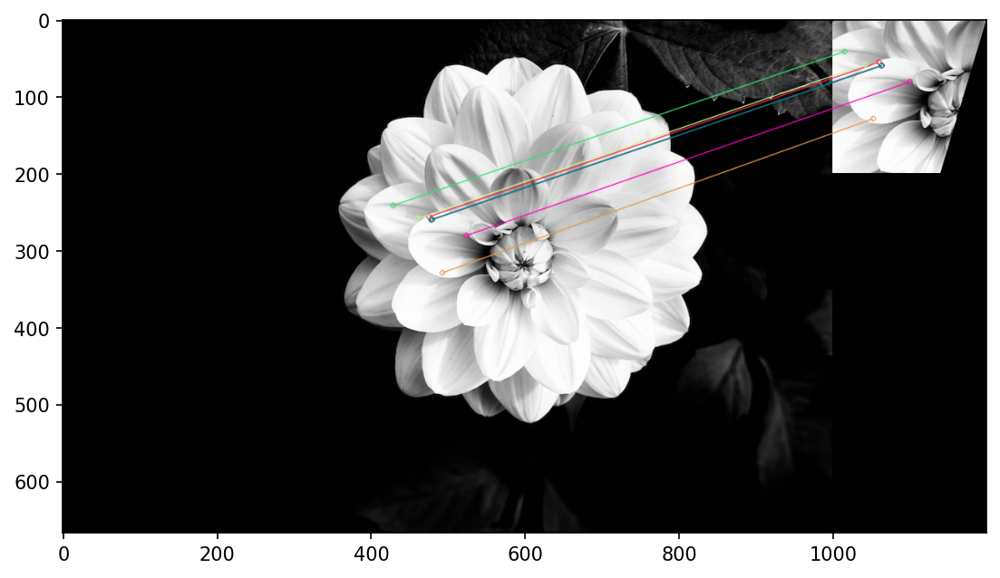

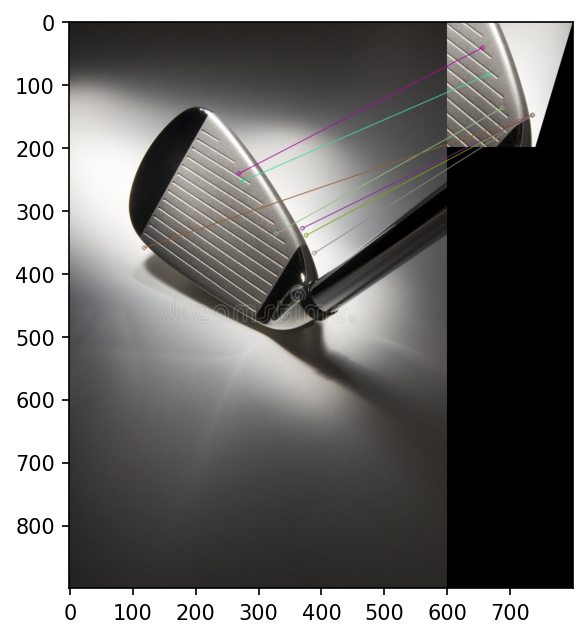

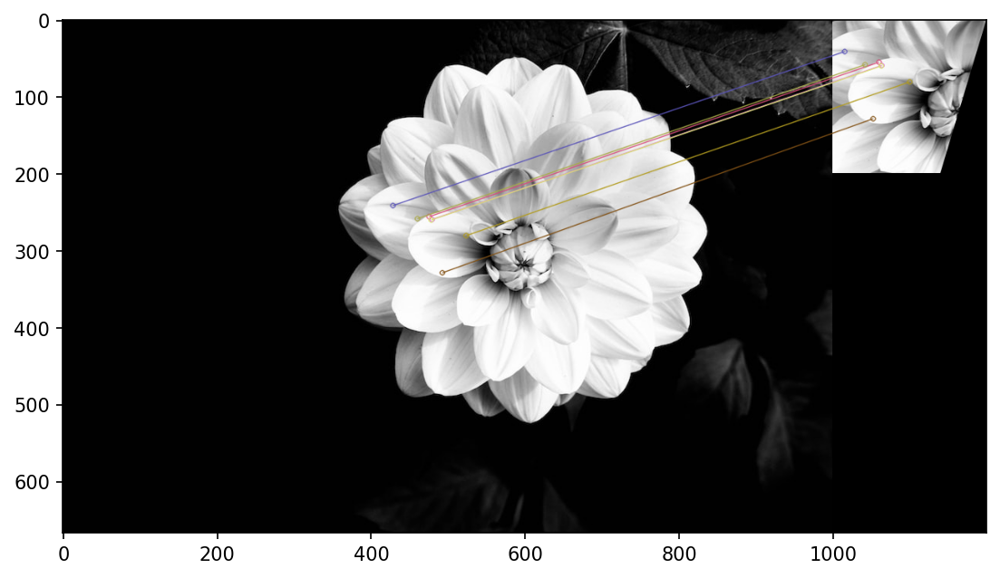

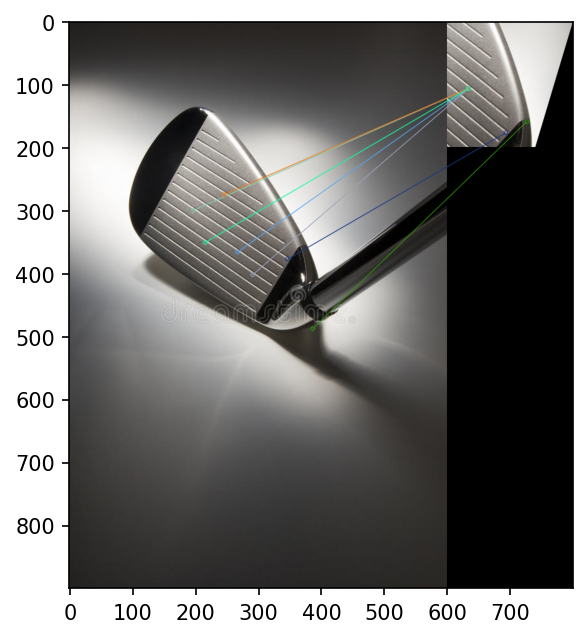

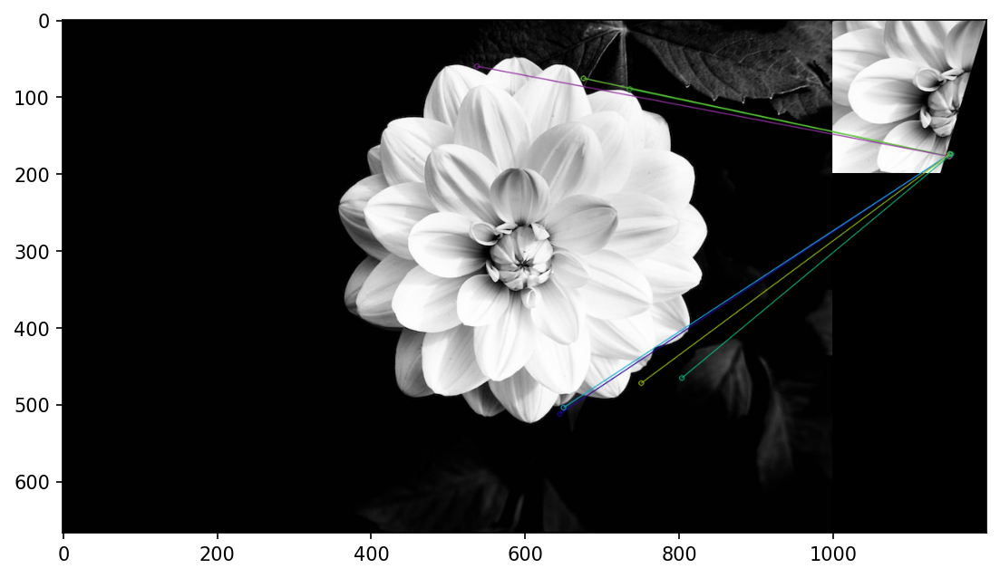

In [70]:
visualize(image=surf_bf_matcher(image=image_1, query=query_1_2, matches_number=7))
visualize(image=surf_bf_matcher(image=image_2, query=query_2_2, matches_number=7))
visualize(image=surf_custom_matcher(image=image_1, query=query_1_2, matches_number=7))
visualize(image=surf_custom_matcher(image=image_2, query=query_2_2, matches_number=7))
visualize(image=surf_ransac_matcher(image=image_1, query=query_1_2, matches_number=7))
visualize(image=surf_ransac_matcher(image=image_2, query=query_2_2, matches_number=7))

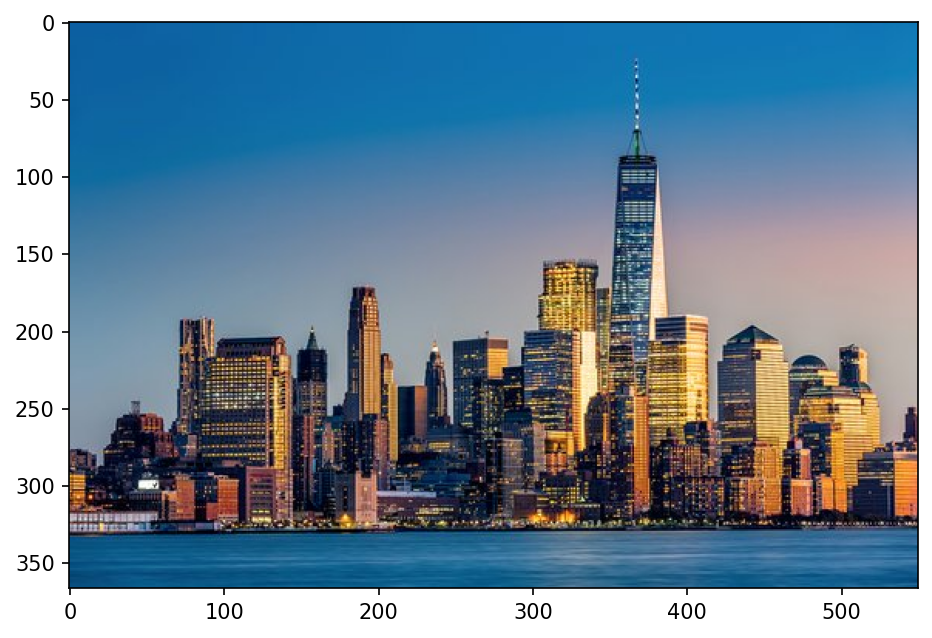

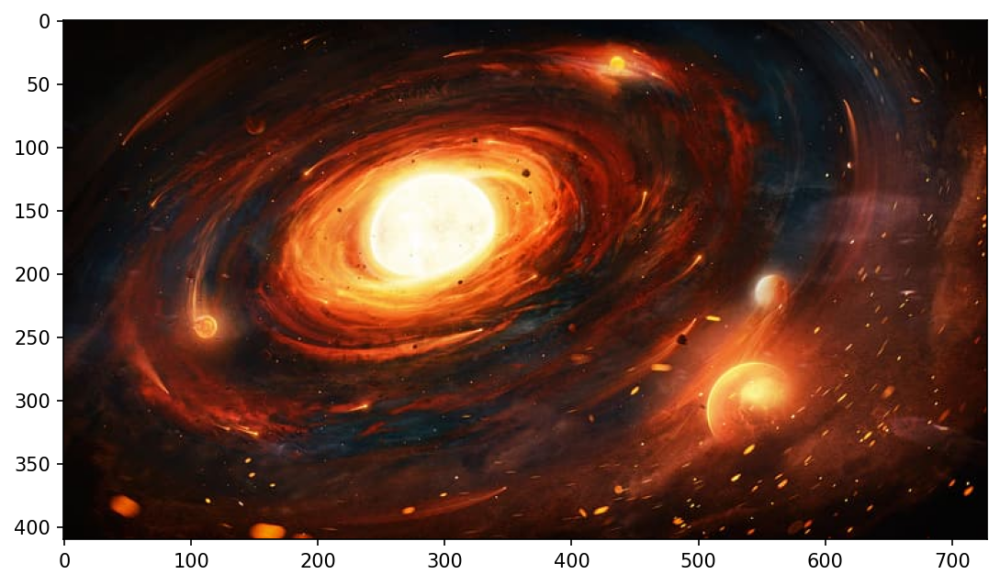

In [71]:
image_3 = read(file=file_3)
image_4 = read(file=file_4)
visualize(image=image_3)
visualize(image=image_4)

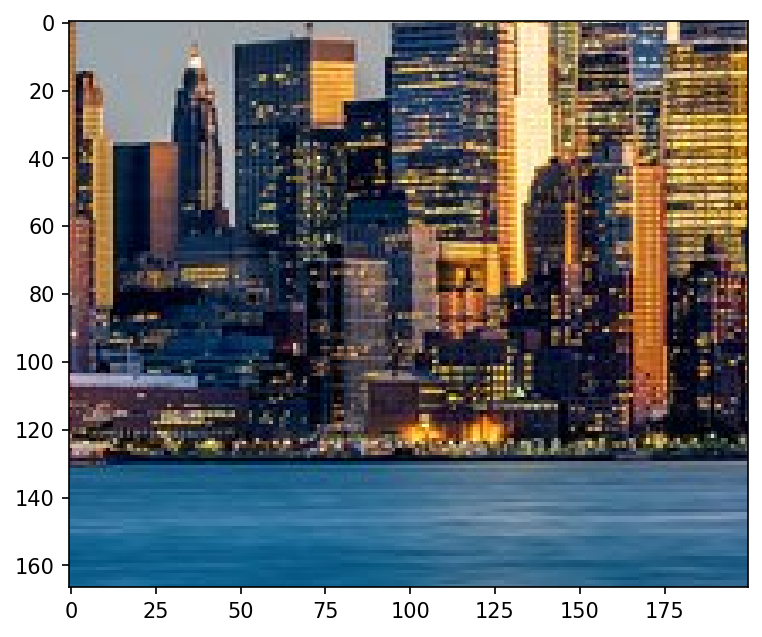

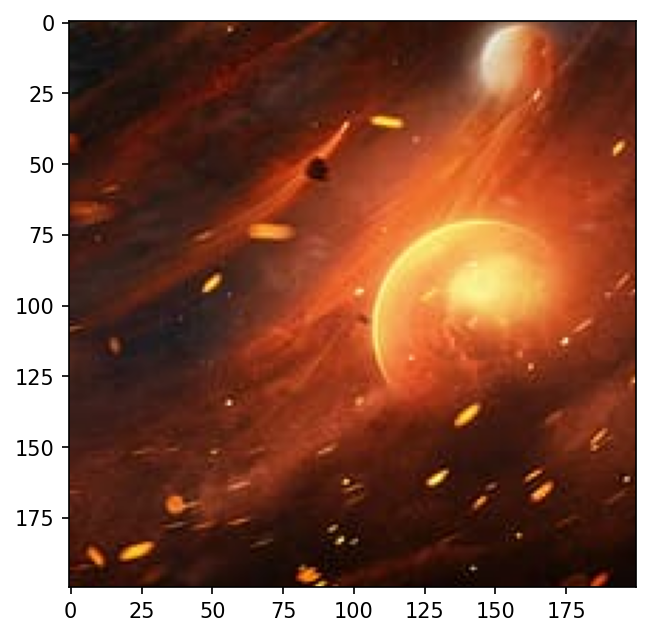

In [72]:
crop_3 = image_3[200:400, 200:400]
crop_4 = image_4[200:400, 400:600]
visualize(image=crop_3)
visualize(image=crop_4)

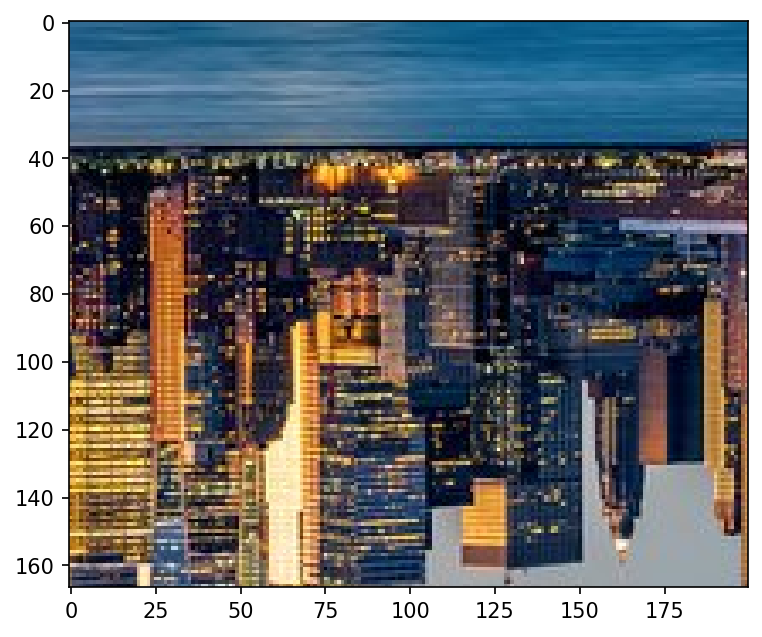

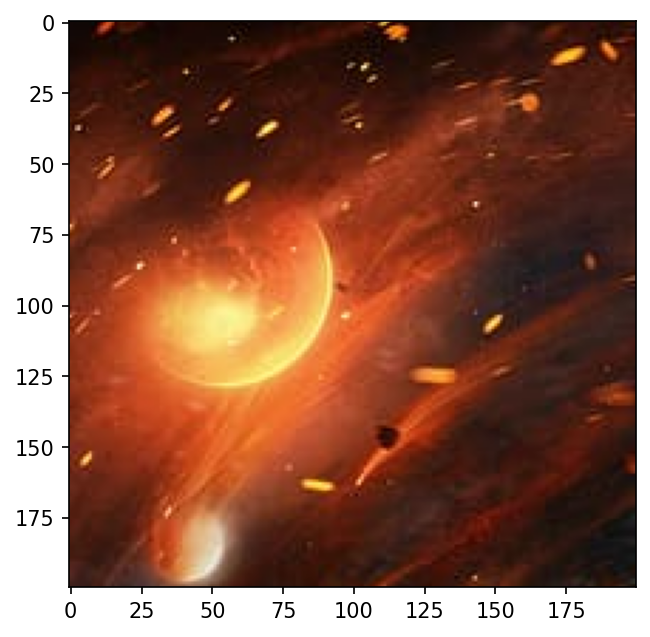

In [73]:
query_3 = cv.rotate(crop_3, cv.ROTATE_180)
query_4 = cv.rotate(crop_4, cv.ROTATE_180)
visualize(image=query_3)
visualize(image=query_4)

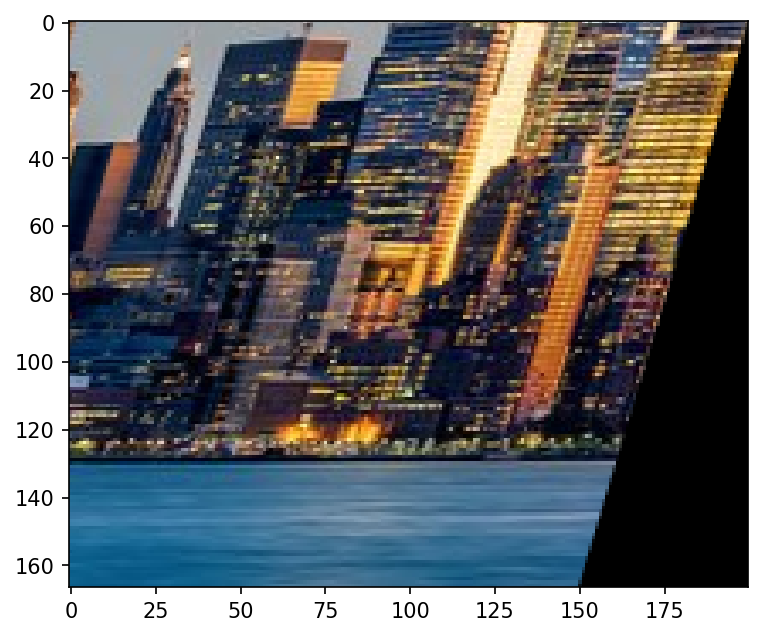

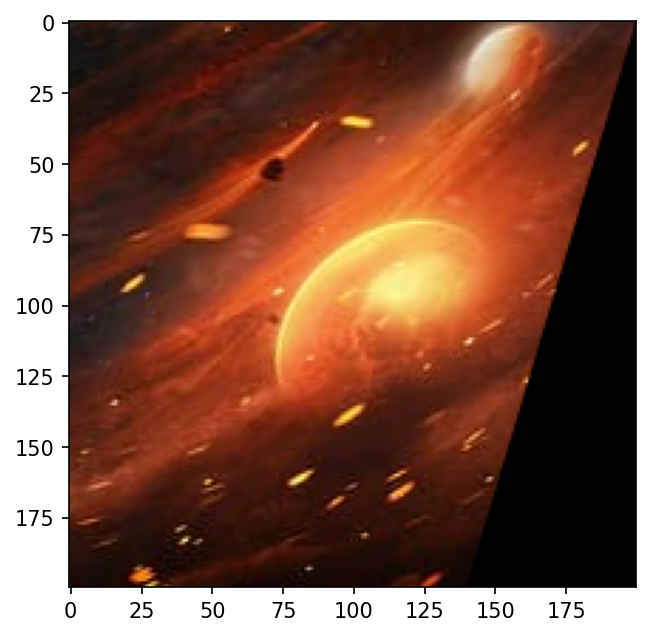

In [74]:
query_3_2 = cv.warpAffine(crop_3, np.array([[1, -0.3, 0], [0, 1, 0]]), crop_3.shape[:2][::-1])
query_4_2 = cv.warpAffine(crop_4, np.array([[1, -0.3, 0], [0, 1, 0]]), crop_4.shape[:2][::-1])
#query2 = cv.warpAffine(crop, np.array([[1, 0, 0], [0.3, 1, 0]]), crop.shape[:2][::-1]) y
visualize(image=query_3_2)
visualize(image=query_4_2)

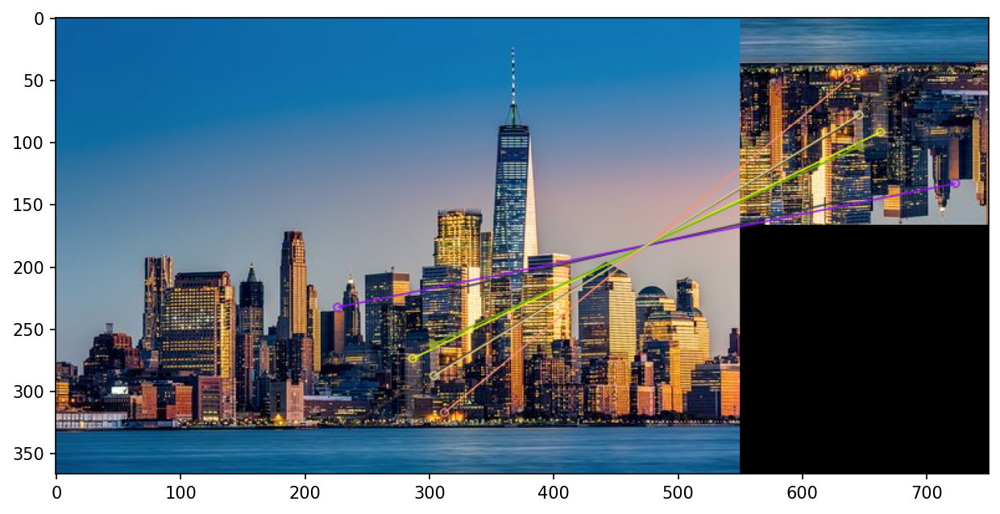

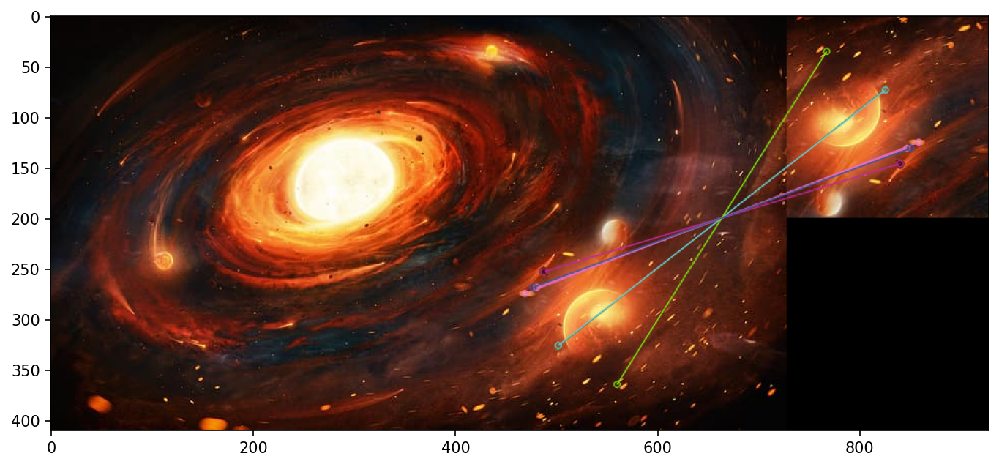

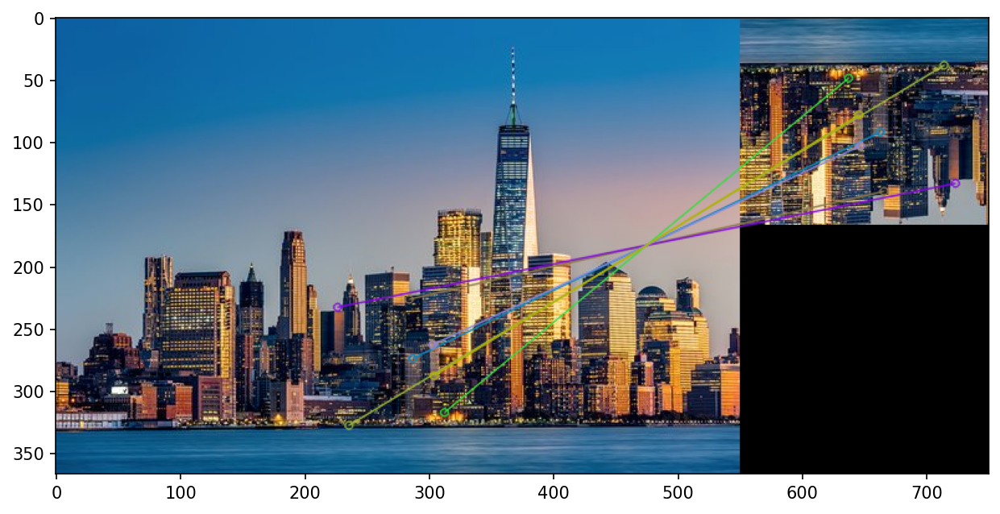

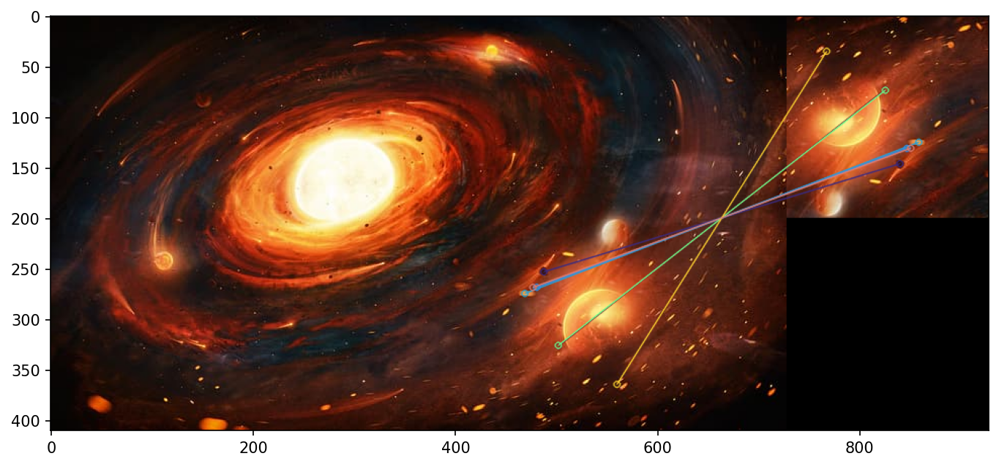

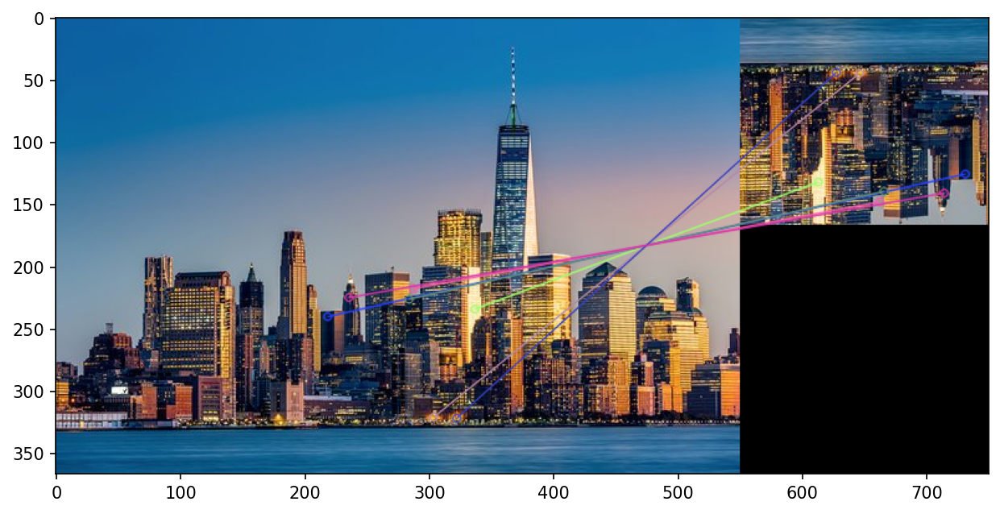

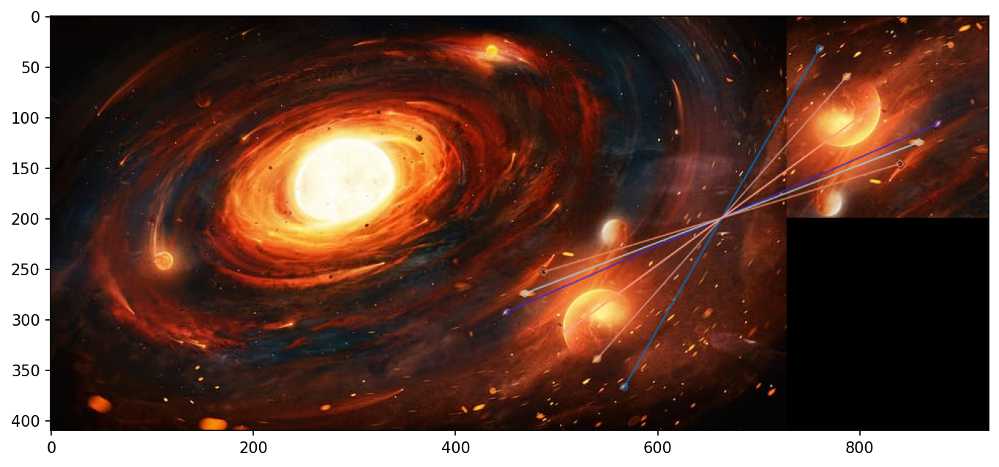

In [75]:
visualize(image=surf_bf_matcher(image=image_3, query=query_3, matches_number=7))
visualize(image=surf_bf_matcher(image=image_4, query=query_4, matches_number=7))
visualize(image=surf_custom_matcher(image=image_3, query=query_3, matches_number=7))
visualize(image=surf_custom_matcher(image=image_4, query=query_4, matches_number=7))
visualize(image=surf_ransac_matcher(image=image_3, query=query_3, matches_number=7))
visualize(image=surf_ransac_matcher(image=image_4, query=query_4, matches_number=7))

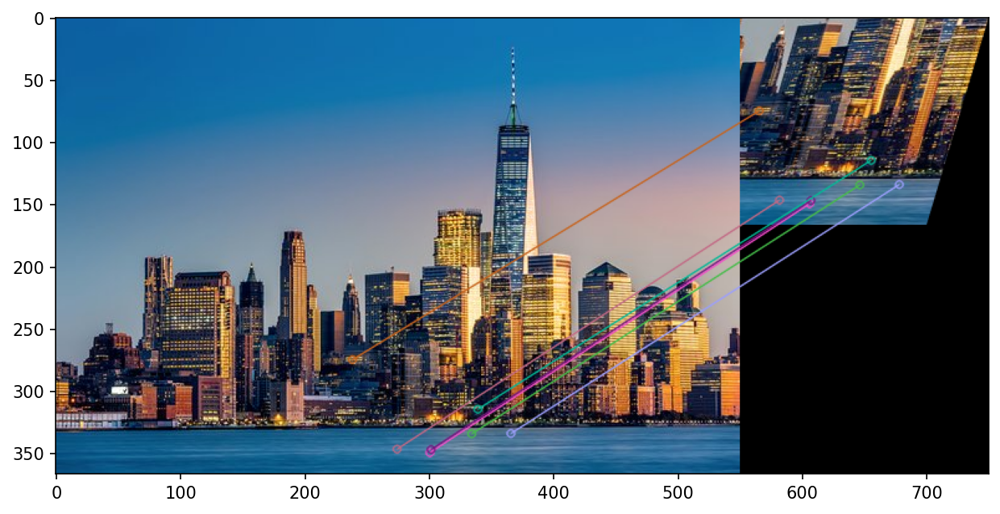

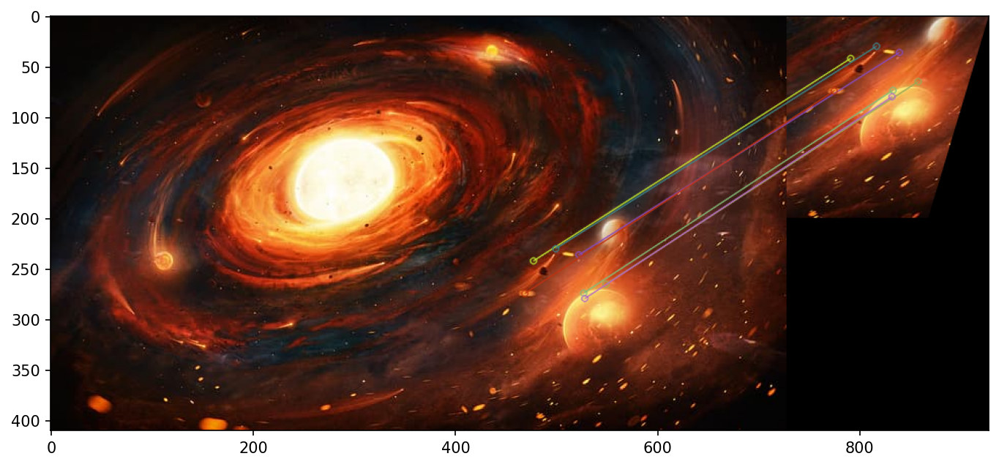

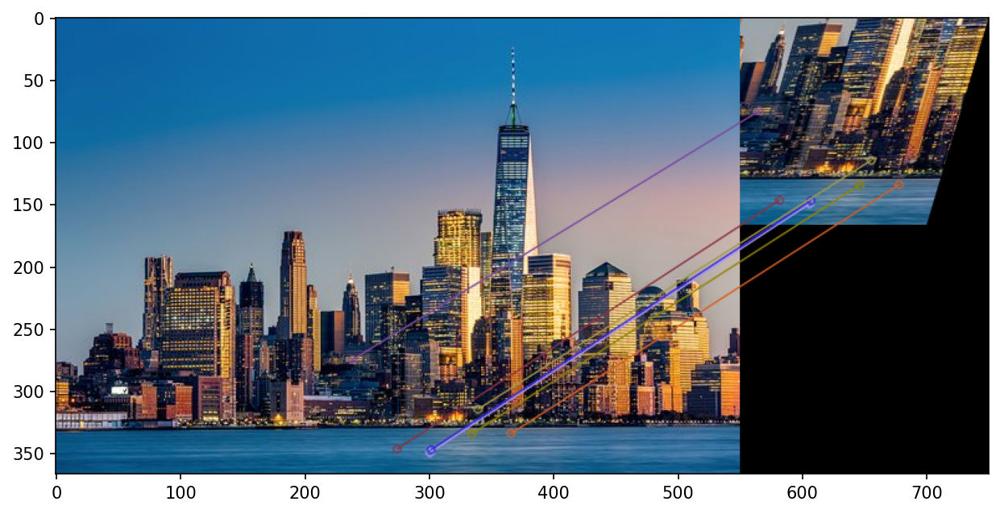

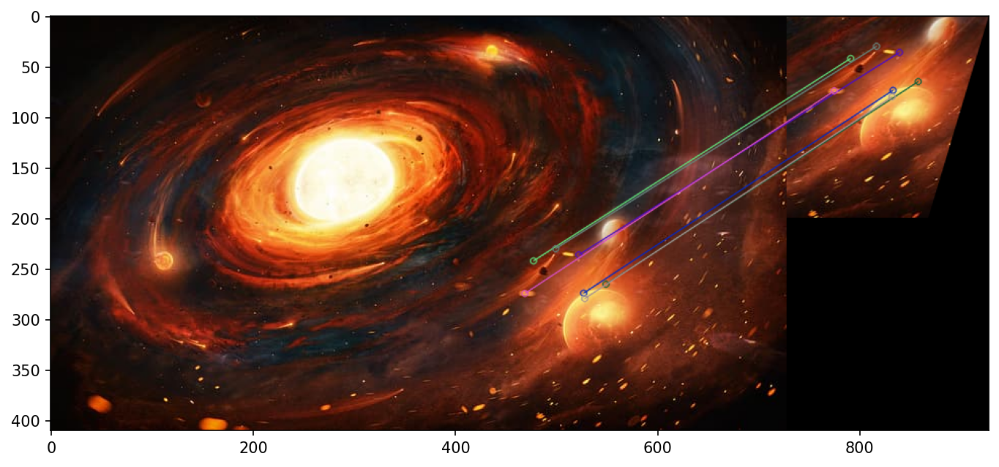

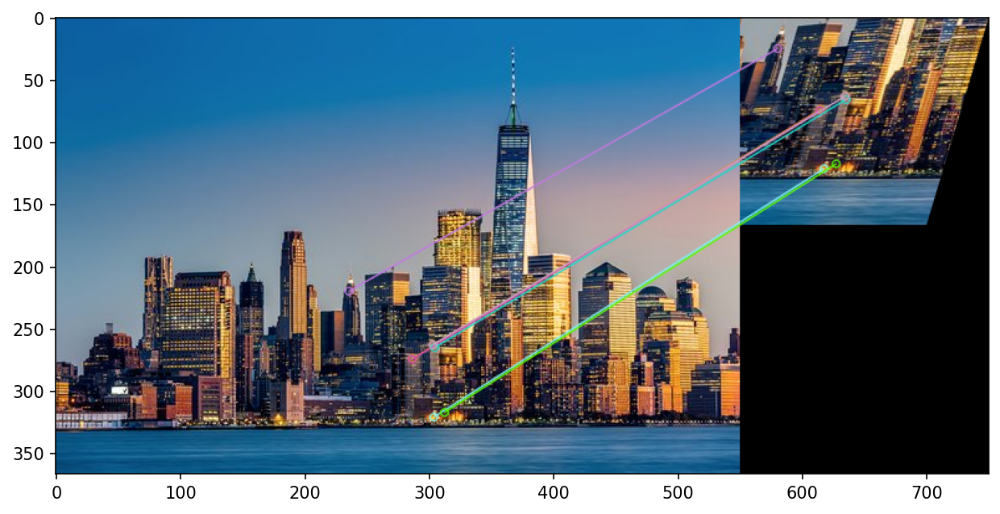

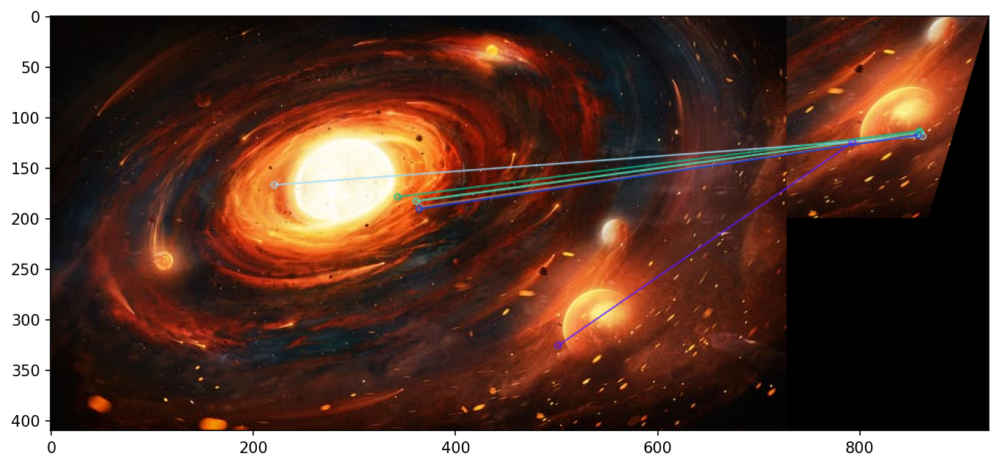

In [76]:
visualize(image=surf_bf_matcher(image=image_3, query=query_3_2, matches_number=7))
visualize(image=surf_bf_matcher(image=image_4, query=query_4_2, matches_number=7))
visualize(image=surf_custom_matcher(image=image_3, query=query_3_2, matches_number=7))
visualize(image=surf_custom_matcher(image=image_4, query=query_4_2, matches_number=7))
visualize(image=surf_ransac_matcher(image=image_3, query=query_3_2, matches_number=7))
visualize(image=surf_ransac_matcher(image=image_4, query=query_4_2, matches_number=7))